**Team 1 :**
   * Shobhit Aggarwal (shobhita)
   * Ho Kit Fu (hoikitf)
   * Shiyuan Li (shiyuan2)

## Import and Headers Translation

In [1]:
#pip install plotly
#pip install dataprep

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
from dataprep.eda import create_report
import plotly as py
import plotly.offline as pyo
import plotly.graph_objs as go
import matplotlib.pyplot as plt
from dataprep.eda import create_report

#READ EXCEL DATA FILE AND SHEET NAMES TO BE ANALYZED
data_xl = pd.ExcelFile('./Balance - Tablas (Parte 1 ).xlsx')
SA_sheets = data_xl.sheet_names[0:12]
print(SA_sheets)

#READING SPECIFIC SHEETS TO DATAFRAME DICTIONARY
list_pandas = []
list_columns = []
for i in range(12):
    list_pandas.append(data_xl.parse(SA_sheets[i]))
    list_columns.append(list_pandas[i].columns)

#READING COLUMN HEADER DICTIONARY SPANISH TO ENGLISH
translate_dict = pd.read_excel('./DataDictionary.xlsx')
translate_dict.head(3)
dict_dictionary = dict(zip(translate_dict['Field'], translate_dict['Description']))

#TRANSLATING HEADERS
list_columns_t = []
for i in range(len(list_columns)):
    columns_t = []
    for j in range(len(list_columns[i])):
        if list_columns[i][j] in dict_dictionary.keys():
            columns_t.append(dict_dictionary.get(list_columns[i][j]))
        else:
            columns_t.append(list_columns[i][j])
    list_columns_t.append(columns_t)
    
#APPLYING NEW HEADER NAMES
for i in range(len(list_pandas)):
#    print(i,"--",list_pandas[i].shape) #CHECKING BEFORE AND AFTER DF SHAPE
    list_pandas[i].columns = list_columns_t[i]
#    print(i,"--",list_pandas[i].shape) #CHECKING BEFORE AND AFTER DF SHAPE

NumExpr defaulting to 8 threads.


['agenda', 'deteccioncomplicacionesma', 'deteccioncomplicacionesre', 'hc', 'hc_hospitalizaciones', 'historialcitascanceladas', 'historialcitasagendadas', 'pacientes', 'paquetes', 'periodosrecetas', 'pr_razones', 'prospectos']


In [3]:
table_shorthands = ['agenda', 'dc_ma', 'dc_re', 'hc', 'hch', 'capp', 'sapp', 'patient', 'packages', 'pp', 'pr_reasons', 'prospectos']

for i in range(len(table_shorthands)):
    globals()[table_shorthands[i]] = list_pandas[i]

### "Balance - Tablas (Parte 1 )" Tables

1. **agenda**: patients' agenda data

2. **deteccioncomplicacionesma**: *dc_ma* - detection complications ma

3. **deteccioncomplicacionesre**: *dc_re* - detection complications re

4. **hc**: patients's medical history records

5. **hc_hospitalizaciones**	 *hch* : Patient medical records of hospitalization

6. **historialcitascanceladas**	 *capp* : Cancelled Appointments

7. **historialcitasagendadas**	 *sapp* : Scheduled Appointments

8. **pacientes**	 *patient* : Patient profile and information

9. **paquetes**	 *packages* :

10. **periodosrecetas**	 *pp* :

11. **pr_razones**	 *pr_reasons* :

12. **prospectos** :

## Profiling and cleaning dataset

In [4]:
df1 = list_pandas[0]
df2 = list_pandas[1]
df3 = list_pandas[2]
df4 = list_pandas[3]

#### The agenda data frame

In [5]:
### Get the basic summary of the agenda data frame.
### Since the numerical data fields are only Agenda ID, Patient ID and Consulting ID, it's meaningless to 
### get the summary statistics for these numerical data
print(agenda.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150308 entries, 0 to 150307
Data columns (total 11 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   Agenda ID           150308 non-null  int64  
 1   Patient ID          144067 non-null  float64
 2   Available areas     150228 non-null  object 
 3   Create Date         150308 non-null  object 
 4   Create Time         150308 non-null  object 
 5   High Date           150308 non-null  object 
 6   Attendance          141201 non-null  object 
 7   Reason              131011 non-null  object 
 8   Branch id           150308 non-null  int64  
 9   Appointment Status  150306 non-null  object 
 10  ComoSeEnteroCitaAg  5251 non-null    object 
dtypes: float64(1), int64(2), object(8)
memory usage: 12.6+ MB
None


In [6]:
agenda = agenda.astype({'Patient ID':'object', 'Agenda ID':'object', 'Branch id':'object'})
agenda.loc[agenda['High Date']=='0000-00-00','High Date'] = np.nan

In [7]:
print("Number of records: ", agenda.shape[0])
print("Number of columns: ", agenda.shape[1])

Number of records:  150308
Number of columns:  11


In [8]:
### Get the percentage of null value of each feature in the agenda data frame 
print((agenda.isnull().sum() / agenda.shape[0] * 100).sort_values(ascending=False))

ComoSeEnteroCitaAg    96.506507
Reason                12.838305
Attendance             6.058892
Patient ID             4.152141
High Date              1.560130
Available areas        0.053224
Appointment Status     0.001331
Agenda ID              0.000000
Create Date            0.000000
Create Time            0.000000
Branch id              0.000000
dtype: float64


In [9]:
### Get the pie chart of area of patients
colors = ['#eba796', '#96ebda']

fig = {'data' : [{'type' : 'pie',
                  'name' : "Patients by Area: Pie chart",
                 'labels' : agenda['Available areas '].value_counts().index,
                 'values' : agenda['Available areas '].value_counts().values,
                 'direction' : 'clockwise',
                 'marker' : {'colors' : ['#9cc359', '#e96b5c']}}], 'layout' : {'title' : 'Patients by Area'}}

pyo.iplot(fig)

In [10]:
### Get the pie chart of attendance status
colors = ['#eba796', '#96ebda']

fig = {'data' : [{'type' : 'pie',
                  'name' : "Attendance status: Pie chart",
                 'labels' : agenda['Attendance'].value_counts().index,
                 'values' : agenda['Attendance'].value_counts().values,
                 'direction' : 'clockwise',
                 'marker' : {'colors' : ['#9cc359', '#e96b5c']}}], 'layout' : {'title' : 'Attendance status'}}

pyo.iplot(fig)

#### The deteccioncomplicacionesma data frame

In [11]:
### Get the basic summary of the data frame.
print(df2.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600 entries, 0 to 599
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   IdDeteccionMA  600 non-null    int64         
 1   Patient ID     600 non-null    int64         
 2   Create Date    600 non-null    datetime64[ns]
 3   Outcome        600 non-null    object        
 4   Reference      545 non-null    object        
 5   Username       600 non-null    object        
dtypes: datetime64[ns](1), int64(2), object(3)
memory usage: 28.2+ KB
None


In [12]:
print("Number of records: ", df2.shape[0])
print("Number of columns: ", df2.shape[1])

Number of records:  600
Number of columns:  6


In [13]:
### Get the percentage of null value of each feature in the agenda data frame 
print((df2.isnull().sum() / df2.shape[0] * 100).sort_values(ascending=False))

Reference        9.166667
IdDeteccionMA    0.000000
Patient ID       0.000000
Create Date      0.000000
Outcome          0.000000
Username         0.000000
dtype: float64


#### The deteccioncomplicacionesre data frame

In [14]:
### Get the basic summary of the data frame.
print(df3.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194 entries, 0 to 193
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   IdDeteccionRE  194 non-null    int64         
 1   Patient ID     194 non-null    int64         
 2   Outcome        194 non-null    object        
 3   Create Date    194 non-null    datetime64[ns]
 4   Reference      188 non-null    object        
 5   Creation User  194 non-null    object        
dtypes: datetime64[ns](1), int64(2), object(3)
memory usage: 9.2+ KB
None


In [15]:
print("Number of records: ", df3.shape[0])
print("Number of columns: ", df3.shape[1])

Number of records:  194
Number of columns:  6


In [16]:
### Get the percentage of null value of each feature in the agenda data frame 
print((df3.isnull().sum() / df3.shape[0] * 100).sort_values(ascending=False))

Reference        3.092784
IdDeteccionRE    0.000000
Patient ID       0.000000
Outcome          0.000000
Create Date      0.000000
Creation User    0.000000
dtype: float64


#### The hc data frame

In [17]:
### Get the basic summary of the hc data frame.
print(df4.info(verbose = 1))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13582 entries, 0 to 13581
Data columns (total 102 columns):
 #    Column                                                                Dtype         
---   ------                                                                -----         
 0    Patient ID                                                            int64         
 1    Create Date                                                           object        
 2    Create Time                                                           object        
 3    Background Family inherited Diabetes 1 for yes                        int64         
 4    Background Family inherited Hipertension 1 for yes                    int64         
 5    Background Family inherited Premature death 1 for yes                 int64         
 6    Background Family inherited Cancer 1 for yes                          int64         
 7    Background Family inherited Dislipidemia 1 for yes               

In [18]:
print("Number of records: ", df4.shape[0])
print("Number of columns: ", df4.shape[1])

Number of records:  13582
Number of columns:  102


In [19]:
### Get the percentage of null value of each feature in the agenda data frame 
pd.options.display.min_rows = 200
print((df4.isnull().sum() / df4.shape[0] * 100).sort_values(ascending=False))

Pathological personal history cerebrovascular accident Clasification    98.910322
Pathological personal history glaucoma Clasification                    98.579002
Diagnostic Notes                                                        98.564276
Patient consumes Psychoactive Time                                      97.835370
Pathological personal history Obesity Clasification                     97.607127
Pathological personal history Renal disease Clasification               97.577676
Pathological personal history Coronary Treatment                        96.009424
Pathological personal history Cataract Clasification                    94.772493
Background Family inherited Which Other 1 for yes                       94.676778
Pathological personal history Peripheral Vasculopathy Clasification     93.999411
Pathological personal history Allergic notes                            87.741128
Pathological personal history Hypertension Clasification                84.052422
Obstetric-gyneco

In [20]:
dict_ = dict(df4.dtypes)
for feature in df4.columns:
    if dict_[feature] == 'float64':
        x0 = df4[feature].values
        trace0 = go.Box(x=x0, name = feature,
                        marker = dict(
                        color = 'rgb(0, 128, 128)',
                        ))
        data = [trace0]
        pyo.iplot(data)

**hc_hospitalizaciones**	 *hch* : Patient medical records of hospitalization

In [21]:
print(hch.dtypes)
hch = hch.astype({'Patient ID':'object', 'Hospitalization ID':'object'})

Comments              object
Causes                object
Days                   int64
Year                   int64
Patient ID             int64
Hospitalization ID     int64
dtype: object


The *Year* data has mis-entered values which needs to be removed

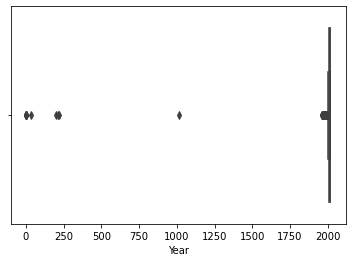

In [22]:
ax = sns.boxplot(x=hch['Year'])

In [23]:
hch.loc[hch['Year']<1900,'Year'] = np.nan

**Causes field is has entry typo with *Hiperglumia* and needs space trimming**

[Text(0, 0, 'HIPERGLUCEMIA'),
 Text(1, 0, 'HIPERTENSION'),
 Text(2, 0, 'HIPOGLUCEMIA'),
 Text(3, 0, 'PANCREATITIS'),
 Text(4, 0, 'COMA DIABETICO'),
 Text(5, 0, 'CRISIS HIPERTENSIVA'),
 Text(6, 0, 'NEUMONIA'),
 Text(7, 0, 'HIPOTIROIDISMO'),
 Text(8, 0, 'HISTERECTOMIA'),
 Text(9, 0, 'EMBOLIA')]

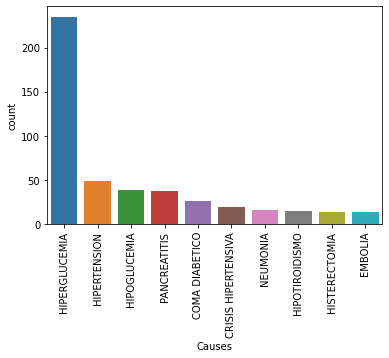

In [24]:
hch['Causes'] = hch['Causes'].str.strip()
hch.loc[hch['Causes']=='HIPERGLICEMIA','Causes'] = 'HIPERGLUCEMIA'
ax = sns.countplot(x='Causes', data=hch, order=pd.value_counts(hch['Causes']).iloc[:10].index)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)

**60% patients are hospitalized for less than 4 days.**

<AxesSubplot:xlabel='Days', ylabel='Count'>

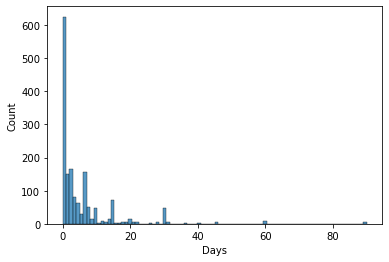

In [25]:
sns.histplot(data=hch, x='Days')

<AxesSubplot:xlabel='Days', ylabel='Count'>

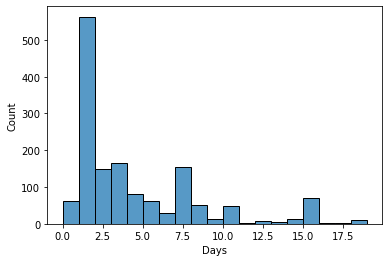

In [26]:
sns.histplot(data=hch[hch['Days']<20], x='Days')

#### historialcitascanceladas - capp: Cancelled appointments

In [27]:
capp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7162 entries, 0 to 7161
Data columns (total 13 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Cancelled Appointments ID  7162 non-null   int64         
 1   Agenda ID                  7162 non-null   int64         
 2   Patient ID                 7147 non-null   float64       
 3   Available areas            7162 non-null   object        
 4   Create Date                7162 non-null   datetime64[ns]
 5   Create Time                7162 non-null   object        
 6   High Date                  7162 non-null   datetime64[ns]
 7   Attendance                 407 non-null    object        
 8   Reason                     6222 non-null   object        
 9   Branch id                  7162 non-null   int64         
 10  Confirmacion               1175 non-null   object        
 11  Appointment Status         7162 non-null   object        
 12  Cancel

* ID parameteres are int64 type which needs to be changed to object.
* Patient IDs are incomplete 8.3%.
* Attendance is missing 94.3% data.

In [28]:
capp = capp.astype({'Patient ID':'object', 'Agenda ID':'object', 'Cancelled Appointments ID':'object', 'Branch id':'object'})
capp.describe(include='object', datetime_is_numeric=True)

,Cancelled Appointments ID,Agenda ID,Patient ID,Available areas,Create Time,Attendance,Reason,Branch id,Confirmacion,Appointment Status
count,7162,7162,7147.0,7162,7162,407,6222,7162,1175,7162
unique,7162,7021,3686.0,7,37,4,10,7,3,1
top,1,2383862,0.0,NUTRICIÓN,10:00:00,ASISTIO,CONSULTA NUTRICION,1,CONFIRMO,AGENDADA
freq,1,3,618.0,2264,879,356,1988,1853,796,7162


In [29]:
#94.3% missing in Attendance and 83.6% missing in Confirmacion. Appointment status has only 1 value
capp = capp.drop({'Attendance','Confirmacion','Appointment Status'},1)

[Text(0, 0, 'NUTRICIÓN'),
 Text(1, 0, 'TODOS'),
 Text(2, 0, 'EXPRESS O MONITOREO'),
 Text(3, 0, 'PSICOLOGÍA'),
 Text(4, 0, 'CONTROL VITAL'),
 Text(5, 0, 'EXPRESS'),
 Text(6, 0, 'PODOLOGIA')]

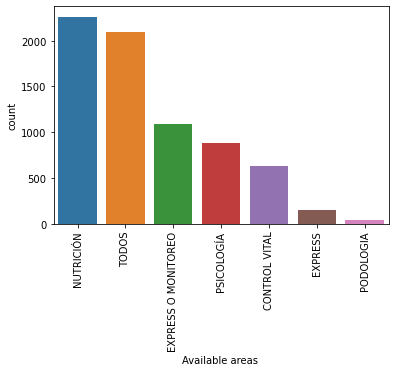

In [30]:
ax = sns.countplot(x="Available areas ",data=capp, order=pd.value_counts(capp['Available areas ']).iloc[:10].index)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)

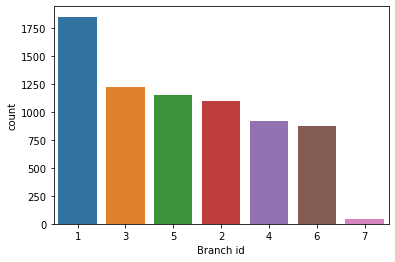

In [31]:
ax = sns.countplot(x="Branch id",data=capp, order=pd.value_counts(capp['Branch id']).iloc[:10].index)

#### historialcitasagendadas - sapp: Scheduled appointments

In [32]:
sapp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10883 entries, 0 to 10882
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   Create Time         10883 non-null  object        
 1   Create Date         10883 non-null  datetime64[ns]
 2   High Date           10883 non-null  datetime64[ns]
 3   Attendance          145 non-null    object        
 4   Reason              10071 non-null  object        
 5   Branch id           10883 non-null  int64         
 6   Appointment Status  10883 non-null  object        
 7   Change Date         10883 non-null  datetime64[ns]
 8   FechaAgenda         0 non-null      float64       
dtypes: datetime64[ns](3), float64(1), int64(1), object(4)
memory usage: 765.3+ KB


In [33]:
sapp = sapp.astype({'Branch id':'object'})
sapp.describe(include='object', datetime_is_numeric=True)

,Create Time,Attendance,Reason,Branch id,Appointment Status
count,10883,145,10071,10883,10883
unique,37,4,10,7,2
top,10:00:00,ASISTIO,CONSULTA NUTRICION,1,AGENDADA
freq,1271,91,2609,3728,10882


In [34]:
sapp = sapp.drop({'FechaAgenda','Attendance'},1)

#### pacientes - patient: Patient profile

In [35]:
patient.head(3)

,Patient ID,YearBirth,Branch id,Town,State,Sex,Marital status,Religion,Ocupacion,Scholarship,Create Date,Create Time,IdInteresado,ProgramaRecomendados,Social Security,RecordarCita,EstadioValor,Estadio
0,1,1928.0,1,GUADALUPE,NUEVO LEÓN,H,SOLTERÍA,CATOLICA,ALBAÑIL,NINGUNA,2013-02-19,13:55:23,16432,0,imss,1,NaN,NaN
1,2,1971.0,1,GUADALUPE,NUEVO LEÓN,H,MATRIMONIO,NaN,INSTALACION MECANICA,LEER Y ESCRIBIR,2013-02-19,13:55:23,16433,0,IMSS,1,NaN,NaN
2,3,1943.0,1,GUADALUPE,NUEVO LEÓN,M,MATRIMONIO,CATOLICA,HOGAR,PREPARATORIA,2013-02-19,13:55:23,16434,0,IMSS,1,8.8,5.0


In [36]:
patient.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14855 entries, 0 to 14854
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Patient ID            14855 non-null  int64         
 1   YearBirth             14813 non-null  float64       
 2   Branch id             14855 non-null  int64         
 3   Town                  14807 non-null  object        
 4   State                 14812 non-null  object        
 5   Sex                   14714 non-null  object        
 6   Marital status        14648 non-null  object        
 7   Religion              5186 non-null   object        
 8   Ocupacion             14236 non-null  object        
 9   Scholarship           5076 non-null   object        
 10  Create Date           14855 non-null  datetime64[ns]
 11  Create Time           14855 non-null  object        
 12  IdInteresado          14855 non-null  int64         
 13  ProgramaRecomend

In [37]:
patient = patient.astype({'Patient ID':'object', 'Branch id':'object', 'ProgramaRecomendados':'object', 'IdInteresado':'object'})
patient.describe(include='all')

<ipython-input-37-80d7bea91bb2>:2: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.



,Patient ID,YearBirth,Branch id,Town,State,Sex,Marital status,Religion,Ocupacion,Scholarship,Create Date,Create Time,IdInteresado,ProgramaRecomendados,Social Security,RecordarCita,EstadioValor,Estadio
count,14855.0,14813.000000,14855.0,14807,14812,14714,14648,5186,14236,5076,14855,14855,14855.0,14855.0,14488,14855.000000,3701.000000,3701.000000
unique,14855.0,NaN,7.0,227,19,2,5,138,234,8,1124,11631,14855.0,2.0,72,NaN,NaN,NaN
top,1.0,NaN,1.0,MONTERREY,NUEVO LEÓN,M,MATRIMONIO,CATOLICA,EMPLEADO,PREPARATORIA,2013-02-19 00:00:00,13:55:23,32768.0,0.0,IMSS,NaN,NaN,NaN
freq,1.0,NaN,6215.0,3148,14713,8278,10492,2809,5196,1313,817,770,1.0,13039.0,8954,NaN,NaN,NaN
first,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013-02-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016-12-30 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1962.313576,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.998452,97.153148,1.366928
std,NaN,12.855983,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.039319,27.069176,0.833052
min,NaN,1900.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000
25%,NaN,1954.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,89.300000,1.000000


  0%|                                                                                         | 0/1726 [00:00<…

DataPrep Report
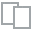
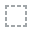
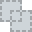
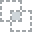
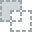
...
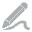
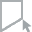
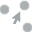
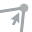
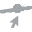

In [38]:
create_report(patient)

In [39]:
#agenda.describe()

## Derive subsets of the outcome variables

*   Skips appointment 
*	Cancels appointment
*	Reschedules appointment

Rescheduled Appointments are ones which were cancelled and scheduled at the same time.

In [40]:
capp['cancellation time'] = pd.DatetimeIndex(capp['Cancellation Date']).time
capp['cancellation day'] = pd.DatetimeIndex(capp['Cancellation Date']).date

capp_t = capp.astype({'cancellation day':'datetime64'})
agenda_t = agenda.astype({'High Date':'datetime64'})

In [41]:
#Take a right merge join from merging appointments attended and cancelled appointments. 
#We can eliminate rescheduled appointments from cancelled appointments to get cancelled and skipped rows

#Rescheduled Appointments are ones which were cancelled and scheduled at the same time.

reschedule = pd.merge(agenda_t, capp_t, how='right', left_on=['Patient ID','High Date','Available areas '], right_on = ['Patient ID','cancellation day', 'Available areas '])

#setting aside data for cancelled and skipped appointments.
c_app = reschedule[pd.isna(reschedule['Agenda ID_x'])]
c_app = c_app[['Patient ID', 'Available areas ', 'Cancelled Appointments ID',
       'Agenda ID_y', 'Create Date_y', 'Create Time_y', 'High Date_y',
       'Reason_y', 'Branch id_y', 'Cancellation Date', 'cancellation time',
       'cancellation day']]
#filtering data for rescheduled appointments
reschedule = reschedule[~(pd.isna(reschedule['Agenda ID_x']))]
reschedule = reschedule[reschedule['Patient ID']!=0]
reschedule = reschedule[~pd.isna(reschedule['Patient ID'])]
reschedule = reschedule[['Patient ID', 'Available areas ', 'Create Date_x','Create Time_x',
                         'Branch id_x','Reason_x', 'Create Date_y', 
                         'Create Time_y', 'High Date_y', 'Reason_y', 'Branch id_y', 
                         'Cancellation Date', 'Agenda ID_x', 'Agenda ID_y', 'Cancelled Appointments ID']]

reschedule.columns = ['Patient ID', 'Areas', 'New Date', 'New Time',
                      'Rescheduled Branch id', 'New Reason', 'Old Date', 
                      'Old Time', 'Original Create Date', 'Old Reason', 'Old Branch id',
                      'Reschedule Date', 'New Agenda ID', 'Old Agenda ID', 'Cancelled Appointments ID']

In [42]:
reschedule.head(10)

,Patient ID,Areas,New Date,New Time,Rescheduled Branch id,New Reason,Old Date,Old Time,Original Create Date,Old Reason,Old Branch id,Reschedule Date,New Agenda ID,Old Agenda ID,Cancelled Appointments ID
0,6979.0,NUTRICIÓN,2015-09-03 00:00:00,15:00:00,3,NaN,2015-09-03,10:30:00,2014-10-27,NaN,3,2015-09-02 15:01:46,162217,94770,1
3,4966.0,NUTRICIÓN,2015-10-07 00:00:00,15:00:00,1,NaN,2015-10-07,15:00:00,2015-09-02,CONSULTA NUTRICION,1,2015-09-02 18:45:21,171036,230130,4
44,7239.0,PSICOLOGÍA,2015-11-09 00:00:00,09:30:00,3,NaN,2015-09-21,10:45:00,2014-10-27,MONITOREO,3,2015-09-09 12:17:27,259267,95545,46
57,7336.0,TODOS,2015-12-14 00:00:00,10:00:00,1,1ER. SEG. 3 MESES,2015-09-15,09:00:00,2015-09-02,INICIO DE PAQUETE,1,2015-09-11 10:39:22,264097,215926,59
58,7336.0,TODOS,2015-12-14 00:00:00,10:00:00,1,1ER. SEG. 3 MESES,2015-09-15,09:00:00,2015-09-02,INICIO DE PAQUETE,1,2015-09-11 10:39:22,264104,215926,59
72,7357.0,TODOS,2016-03-12 00:00:00,09:00:00,2,2DO. SEG. 6 MESES,2015-09-14,09:00:00,2015-09-04,INICIO DE PAQUETE,2,2015-09-12 13:18:15,301124,247522,73
79,5787.0,TODOS,2015-10-26 00:00:00,11:00:00,3,2DO. SEG. 6 MESES,2015-10-28,11:45:00,2014-10-27,2DO. SEG. 6 MESES,3,2015-09-15 11:53:30,303651,97141,80
88,5670.0,TODOS,2015-10-21 00:00:00,17:00:00,3,3ER. SEG. 9 MESES,2015-09-18,10:00:00,2015-09-02,2DO. SEG. 6 MESES,3,2015-09-15 16:35:25,303206,181732,89
219,5365.0,PSICOLOGÍA,2015-11-02 00:00:00,11:00:00,3,NaN,2015-10-29,08:00:00,2015-09-22,NaN,3,2015-09-29 08:52:42,312281,309229,217
220,5365.0,NUTRICIÓN,2015-11-02 00:00:00,11:00:00,3,NaN,2015-10-29,08:00:00,2015-09-22,NaN,3,2015-09-29 08:52:46,312280,309228,218


In [43]:
reschedule.describe(include="all", datetime_is_numeric=True)

,Patient ID,Areas,New Date,New Time,Rescheduled Branch id,New Reason,Old Date,Old Time,Original Create Date,Old Reason,Old Branch id,Reschedule Date,New Agenda ID,Old Agenda ID,Cancelled Appointments ID
count,597.000000,597,597,597,597.0,588,597,597,597,555,597.0,597,597.0,597.0,597.0
unique,NaN,4,226,29,7.0,8,NaN,23,NaN,8,7.0,NaN,573.0,563.0,569.0
top,NaN,TODOS,2016-05-11 00:00:00,09:00:00,2.0,CONSULTA NUTRICION,NaN,10:00:00,NaN,CONSULTA NUTRICION,2.0,NaN,921563.0,437687.0,2270.0
freq,NaN,248,10,78,140.0,236,NaN,74,NaN,217,143.0,NaN,3.0,3.0,3.0
mean,8994.780570,NaN,NaN,NaN,NaN,NaN,2016-07-02 02:46:25.929648384,NaN,2016-04-07 07:18:59.698492416,NaN,NaN,2016-06-20 10:11:35.165829120,NaN,NaN,NaN
min,37.000000,NaN,NaN,NaN,NaN,NaN,2015-09-03 00:00:00,NaN,2014-10-27 00:00:00,NaN,NaN,2015-09-02 15:01:46,NaN,NaN,NaN
25%,7325.000000,NaN,NaN,NaN,NaN,NaN,2016-04-26 00:00:00,NaN,2016-02-08 00:00:00,NaN,NaN,2016-04-12 18:14:51,NaN,NaN,NaN
50%,9448.000000,NaN,NaN,NaN,NaN,NaN,2016-06-11 00:00:00,NaN,2016-04-16 00:00:00,NaN,NaN,2016-05-19 09:33:44,NaN,NaN,NaN
75%,10837.000000,NaN,NaN,NaN,NaN,NaN,2016-09-23 00:00:00,NaN,2016-06-01 00:00:00,NaN,NaN,2016-09-10 12:43:51,NaN,NaN,NaN
max,14889.000000,NaN,NaN,NaN,NaN,NaN,2016-12-31 00:00:00,NaN,2016-12-13 00:00:00,NaN,NaN,2016-12-27 17:58:05,NaN,NaN,NaN


In [44]:
reschedule.to_csv("Reschedules Appointment.csv", index=False)

Using cancelled appointments table for getting skipped appointment and cancelled appointments
* if cancellation date/time is before appointment date/time, then classify that row as "cancelled appointment"
* if cancellation date/time is after appointment date/time, then classify that row as "skipped appointment".
    Assuming that appointment gets automatically cancelled if the patient skips appointment.


In [45]:
#CLASSIFYING CANCELLATION ROW ITEMS AS SKIP OR CANCELLED APPOINTMENTS

c_app.columns = ['Patient ID', 'Available areas ', 'Cancelled Appointments ID',
       'Agenda ID', 'Create Date', 'Create Time', 'High Date',
       'Reason', 'Branch id', 'Cancellation Date', 'cancellation time',
       'cancellation day']

c_app['cancel?'] = np.nan
c_app.loc[(c_app['cancellation day']<c_app['Create Date']),'cancel?']='cancel'
c_app.loc[pd.isna(c_app['cancel?']),'cancel?']='pot skip'

c_app['skip?'] = np.nan
c_app.loc[(c_app['cancellation time']>c_app['Create Time']),'skip?']='skip'

c_app['skip/cancel'] = 'cancel'
c_app.loc[(c_app['cancel?']=='pot skip') & (c_app['skip?']=='skip'),'skip/cancel'] = 'skip'
c_app.loc[pd.isna(c_app['skip/cancel']),'skip/cancel'] = 'cancel'

c_app = c_app.drop({'skip?','cancel?'},1)

#==============================================================
#CREATING CANCELS APPOINTMENT DATAFRAME FROM ABOVE CLASSICATION

cancel = c_app[['Patient ID','Available areas ', 
               'Create Date', 'Create Time', 'High Date', 'Reason',
               'Branch id', 'Cancelled Appointments ID', 'Cancellation Date', 'skip/cancel']]

cancel = cancel[cancel['skip/cancel']=='cancel']
cancel = cancel.drop({'skip/cancel'},1)

cancel.columns = ['Patient ID', 'Areas ', 'Appointment Date', 
                  'Appointment Time', 'Date Added', 'Reason',
                  'Branch id','Cancelled ID', 'Cancellation Date']


#==============================================================
#CREATING SKIPS APPOINTMENT DATAFRAME FROM ABOVE CLASSICATION

skips = c_app[['Patient ID','Available areas ', 
               'Create Date', 'Create Time', 'High Date', 'Reason',
               'Branch id', 'Cancelled Appointments ID', 'Cancellation Date', 'skip/cancel']]

skips = skips[skips['skip/cancel']=='skip']
skips = skips.drop({'skip/cancel'},1)

skips.columns = ['Patient ID', 'Areas ', 'Appointment Date', 
                  'Appointment Time', 'Date Added', 'Reason',
                  'Branch id','Cancelled ID', 'Cancellation Date']


In [46]:
cancel.head(10)

,Patient ID,Areas,Appointment Date,Appointment Time,Date Added,Reason,Branch id,Cancelled ID,Cancellation Date
1,3385.0,CONTROL VITAL,2015-10-02,09:00:00,2015-09-02,NaN,3,2,2015-09-02 15:06:21
2,3385.0,NUTRICIÓN,2015-10-02,09:00:00,2015-09-02,NaN,3,3,2015-09-02 15:06:37
4,6303.0,CONTROL VITAL,2015-10-01,12:00:00,2015-09-02,NaN,1,6,2015-09-03 09:01:47
5,6303.0,NUTRICIÓN,2015-10-01,12:00:00,2015-09-02,NaN,1,7,2015-09-03 09:01:58
6,6438.0,CONTROL VITAL,2015-09-03,11:30:00,2014-10-10,CONSULTA PSICOLOGIA,1,8,2015-09-03 09:43:44
7,6639.0,NUTRICIÓN,2015-09-08,09:00:00,2015-09-02,NaN,1,9,2015-09-03 10:16:35
8,6332.0,CONTROL VITAL,2015-10-02,08:30:00,2015-09-02,CONSULTA NUTRICION,4,10,2015-09-03 10:56:53
9,6865.0,PSICOLOGÍA,2015-09-08,14:15:00,2014-10-10,MONITOREO,1,11,2015-09-03 12:24:24
10,4971.0,TODOS,2015-10-22,09:00:00,2014-10-27,3ER. SEG. 9 MESES,3,12,2015-09-03 14:26:55
11,7248.0,CONTROL VITAL,2015-10-05,13:00:00,2015-09-02,CONSULTA NUTRICION,1,13,2015-09-03 16:35:34


In [47]:
cancel.describe(include='all', datetime_is_numeric=True)

,Patient ID,Areas,Appointment Date,Appointment Time,Date Added,Reason,Branch id,Cancelled ID,Cancellation Date
count,5783.000000,5795,5795,5795,5795,4959,5795.0,5795.0,5795
unique,NaN,7,NaN,34,NaN,10,7.0,5795.0,NaN
top,NaN,NUTRICIÓN,NaN,10:00:00,NaN,CONSULTA NUTRICION,1.0,2.0,NaN
freq,NaN,1883,NaN,729,NaN,1654,1472.0,1.0,NaN
mean,8391.299499,NaN,2016-06-05 05:31:14.236410624,NaN,2016-02-21 23:05:19.930974976,NaN,NaN,NaN,2016-05-23 18:00:00.617601280
min,0.000000,NaN,2015-09-03 00:00:00,NaN,2014-10-10 00:00:00,NaN,NaN,NaN,2015-09-02 15:06:21
25%,6521.500000,NaN,2016-02-12 00:00:00,NaN,2015-10-19 00:00:00,NaN,NaN,NaN,2016-01-29 12:05:58.500000
50%,8623.000000,NaN,2016-06-25 00:00:00,NaN,2016-04-04 00:00:00,NaN,NaN,NaN,2016-06-08 15:02:32
75%,11012.000000,NaN,2016-10-01 00:00:00,NaN,2016-06-01 00:00:00,NaN,NaN,NaN,2016-09-17 12:45:02
max,14930.000000,NaN,2016-12-31 00:00:00,NaN,2016-12-21 00:00:00,NaN,NaN,NaN,2016-12-30 15:01:00


In [48]:
cancel.to_csv('CancelsAppointment.csv', index=False)

In [49]:
skips.head(10)

,Patient ID,Areas,Appointment Date,Appointment Time,Date Added,Reason,Branch id,Cancelled ID,Cancellation Date
31,7299.0,TODOS,2015-09-07,17:00:00,2015-09-02,NaN,2,33,2015-09-07 17:14:20
36,5082.0,NUTRICIÓN,2015-09-08,10:45:00,2015-06-02,CONSULTA PSICOLOGIA,2,38,2015-09-08 11:22:59
39,5066.0,CONTROL VITAL,2015-09-08,13:00:00,2015-09-02,NaN,1,41,2015-09-08 13:06:53
40,6596.0,CONTROL VITAL,2015-09-08,15:00:00,2015-09-02,MONITOREO,3,42,2015-09-08 16:50:00
43,5001.0,CONTROL VITAL,2015-09-09,09:00:00,2015-09-02,2DO. SEG. 6 MESES,2,45,2015-09-09 09:21:54
63,3139.0,NUTRICIÓN,2015-09-11,15:00:00,2015-09-02,NaN,1,64,2015-09-11 16:37:53
108,952.0,TODOS,2015-09-18,11:00:00,2015-09-02,NaN,1,109,2015-09-18 11:14:29
135,6216.0,TODOS,2015-09-22,11:00:00,2015-09-02,1ER. SEG. 3 MESES,5,136,2015-09-22 11:05:03
136,5381.0,CONTROL VITAL,2015-09-22,11:00:00,2015-09-02,MONITOREO,1,137,2015-09-22 11:07:43
137,5381.0,NUTRICIÓN,2015-09-22,11:00:00,2015-09-02,NaN,1,138,2015-09-22 11:07:50


In [50]:
skips.describe(include='all', datetime_is_numeric=True)

,Patient ID,Areas,Appointment Date,Appointment Time,Date Added,Reason,Branch id,Cancelled ID,Cancellation Date
count,453.000000,453,453,453,453,388,453.0,453.0,453
unique,NaN,7,NaN,24,NaN,10,7.0,453.0,NaN
top,NaN,NUTRICIÓN,NaN,08:00:00,NaN,CONSULTA NUTRICION,1.0,4096.0,NaN
freq,NaN,142,NaN,64,NaN,118,98.0,1.0,NaN
mean,8213.366446,NaN,2016-06-25 13:05:09.933774848,NaN,2016-03-21 14:15:05.960264960,NaN,NaN,NaN,2016-06-26 01:51:12.110375168
min,0.000000,NaN,2015-09-07 00:00:00,NaN,2015-06-02 00:00:00,NaN,NaN,NaN,2015-09-07 17:14:20
25%,5669.000000,NaN,2016-02-29 00:00:00,NaN,2015-11-10 00:00:00,NaN,NaN,NaN,2016-02-29 18:38:14
50%,8560.000000,NaN,2016-08-03 00:00:00,NaN,2016-04-30 00:00:00,NaN,NaN,NaN,2016-08-03 10:32:19
75%,11369.000000,NaN,2016-10-27 00:00:00,NaN,2016-06-20 00:00:00,NaN,NaN,NaN,2016-10-27 10:07:46
max,15001.000000,NaN,2016-12-30 00:00:00,NaN,2016-12-02 00:00:00,NaN,NaN,NaN,2016-12-30 11:28:45


In [51]:
skips.to_csv('SkipsAppointment.csv', index=False)

## Derive a subset of the engagement predictor variables


*    Demographics. For example, marital status could be derived from EstadoCivil
*    Geography. For example, distance from clinic is dependent on city and state which are in Ciudad and Estado respectively


In [52]:
pd.set_option('display.max_rows', 50)
pd.options.display.max_rows = 999

In [53]:
#Checking packages shape and output the first 5 rows
print(packages.shape)
print(packages.head())

(11, 6)
   Patient Membership package    Descripcion  Order  DescripcionVE  ActivoVE  \
0                           1     PREVENTIVA     10     Preventivo         1   
1                           2       INTEGRAL     20  Integral Plus         0   
2                           3  INTEGRAL PLUS     30  Integral Plus         1   
3                           4       INFANTIL     40            NaN         0   
4                           5           OTRO     50            NaN         0   

   ActivoBAL  
0          1  
1          0  
2          1  
3          0  
4          0  


In [54]:
#Checking packages shape and output the first 5 rows (periodosrecetas)
print(pp.shape)
print(pp.head())

(32, 2)
   IdPeriodo Descripcion
0          1   Por 1 día
1          2  Por 2 días
2          3  Por 3 días
3          4  Por 4 días
4          5  Por 5 días


In [55]:
#Checking pr_reasons shape and output the first 5 rows
print(pr_reasons.shape)
print(pr_reasons.head())

(6, 2)
   IdRazonPR                       Descripcion
0          1       Me mandan mucha información
1          2        No me interesa el Programa
2          3       No tengo a quien recomendar
3          4          No me lo explicaron bien
4          5  Mala experiencia con el programa


In [56]:
#Checking prospectos shape and output the first 5 rows
print(prospectos.shape)
prospectos.head()

(45525, 25)


,IdProspecto,Town,State,YearBirth,Sex,Marital status,Ocupacion,Scholarship,Social Security,How long ago did you have diabetes,...,glucose,Date Appointment,Reason,Patient ID,SpecifyAsInteger,Branch id,Sales Advisor,Have diabetes,How long ago did you have hypertension?,Expectation
0,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,NaN,NaN,0.0,NaN,1,NaN,NaN,NaN,NaN
1,5,ESCOBEDO,NUEVO LEÓN,1960.0,M,NaN,NaN,NaN,NaN,2 AÑOS,...,371.0,NaN,NaN,0.0,NaN,1,NaN,1.0,NaN,0.0
2,6,NaN,NaN,NaN,H,NaN,NaN,NaN,NaN,NaN,...,0.0,NaN,NaN,0.0,NaN,1,NaN,NaN,NaN,NaN
3,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,NaN,NaN,0.0,NaN,1,NaN,NaN,NaN,NaN
4,8,GUADALUPE,NUEVO LEÓN,NaN,M,NaN,NaN,NaN,IMSS,10 AÑOS,...,224.0,NaN,NaN,0.0,NaN,1,NaN,NaN,NaN,NaN


In [57]:
print(patient.shape)
print(patient.isnull().sum(axis = 0).sort_values())
patient.head()

(14855, 18)
Patient ID                  0
Branch id                   0
RecordarCita                0
ProgramaRecomendados        0
Create Date                 0
Create Time                 0
IdInteresado                0
YearBirth                  42
State                      43
Town                       48
Sex                       141
Marital status            207
Social Security           367
Ocupacion                 619
Religion                 9669
Scholarship              9779
EstadioValor            11154
Estadio                 11154
dtype: int64


,Patient ID,YearBirth,Branch id,Town,State,Sex,Marital status,Religion,Ocupacion,Scholarship,Create Date,Create Time,IdInteresado,ProgramaRecomendados,Social Security,RecordarCita,EstadioValor,Estadio
0,1,1928.0,1,GUADALUPE,NUEVO LEÓN,H,SOLTERÍA,CATOLICA,ALBAÑIL,NINGUNA,2013-02-19,13:55:23,16432,0,imss,1,NaN,NaN
1,2,1971.0,1,GUADALUPE,NUEVO LEÓN,H,MATRIMONIO,NaN,INSTALACION MECANICA,LEER Y ESCRIBIR,2013-02-19,13:55:23,16433,0,IMSS,1,NaN,NaN
2,3,1943.0,1,GUADALUPE,NUEVO LEÓN,M,MATRIMONIO,CATOLICA,HOGAR,PREPARATORIA,2013-02-19,13:55:23,16434,0,IMSS,1,8.8,5.0
3,4,1976.0,1,SANTIAGO,NUEVO LEÓN,H,SOLTERÍA,CATOLICA,EMPLEADO,LICENCIATURA,2013-02-19,13:55:23,16435,0,PRIVADO,1,NaN,NaN
4,5,1958.0,1,GUADALUPE,NUEVO LEÓN,H,MATRIMONIO,CATÓLICA,CASADO,PREPARATORIA,2013-02-19,13:55:23,16436,1,NO SEGURIDAD SOCIAL,1,NaN,NaN


In [58]:
#We decide to delete columns with more than 50% of missing values.
patient = patient.drop(columns=['Estadio'])
patient = patient.drop(columns=['EstadioValor'])
patient = patient.drop(columns=['Scholarship'])
patient = patient.drop(columns=['Religion'])

#Fill NA in numeric columns to be the median 
patient = patient.fillna(patient.median())
#Impute categorical variables by filling with most occurring class
patient = patient.apply(lambda x: x.fillna(x.value_counts().index[0]))

<ipython-input-58-03d3e68ef219>:8: FutureWarning:

DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.



In [59]:
#Shape after removing all the missing columns > 50%
print(patient.shape)
print(patient.isnull().sum(axis = 0).sort_values())
print(patient.head())

(14855, 14)
Patient ID              0
YearBirth               0
Branch id               0
Town                    0
State                   0
Sex                     0
Marital status          0
Ocupacion               0
Create Date             0
Create Time             0
IdInteresado            0
ProgramaRecomendados    0
Social Security         0
RecordarCita            0
dtype: int64
   Patient ID  YearBirth  Branch id       Town       State Sex Marital status  \
0           1     1928.0          1  GUADALUPE  NUEVO LEÓN   H       SOLTERÍA   
1           2     1971.0          1  GUADALUPE  NUEVO LEÓN   H     MATRIMONIO   
2           3     1943.0          1  GUADALUPE  NUEVO LEÓN   M     MATRIMONIO   
3           4     1976.0          1   SANTIAGO  NUEVO LEÓN   H       SOLTERÍA   
4           5     1958.0          1  GUADALUPE  NUEVO LEÓN   H     MATRIMONIO   

               Ocupacion Create Date Create Time  IdInteresado  \
0                ALBAÑIL  2013-02-19    13:55:23         1

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14855 entries, 0 to 14854
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Patient ID            14855 non-null  int64         
 1   YearBirth             14855 non-null  float64       
 2   Branch id             14855 non-null  int64         
 3   Town                  14855 non-null  object        
 4   State                 14855 non-null  object        
 5   Sex                   14855 non-null  object        
 6   Marital status        14855 non-null  object        
 7   Ocupacion             14855 non-null  object        
 8   Create Date           14855 non-null  datetime64[ns]
 9   Create Time           14855 non-null  object        
 10  IdInteresado          14855 non-null  int64         
 11  ProgramaRecomendados  14855 non-null  int64         
 12  Social Security       14855 non-null  object        
 13  RecordarCita    

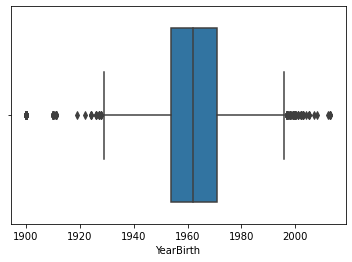

In [60]:
#Q2 Profiling should include at a minimum the number of records in a file, the fields in a record, and for each field, 
#the format of the data, units, the range of values, and summary statistics for numeric data. 
#You should create some data visualizations to understand the range of values and spot outliers

patient.info()
print(patient.describe())
sns.boxplot(x=patient["YearBirth"])
#There is one outlier in the YearBirth variable with YearBirt = 1900, we decide to remove that from our dataset.
patient = patient[patient["YearBirth"] != 1900]

AxesSubplot(0.125,0.125;0.775x0.755)


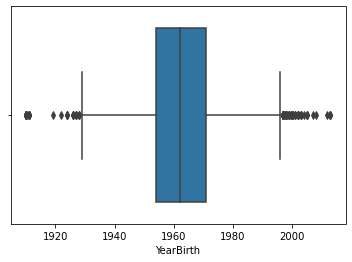

In [61]:
#Check any outlier for "YearBirth"
print(sns.boxplot(x=patient["YearBirth"]))
patient = patient[np.abs(patient["YearBirth"]-patient["YearBirth"].mean()) <= (3*patient["YearBirth"].std())] 

AxesSubplot(0.125,0.125;0.775x0.755)


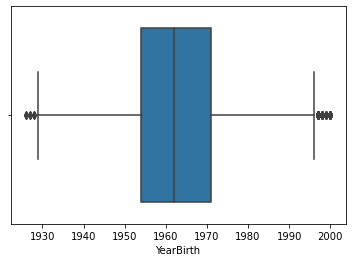

In [62]:
#After removing extreme large values > 3SD
print(sns.boxplot(x=patient["YearBirth"]))

<AxesSubplot:>

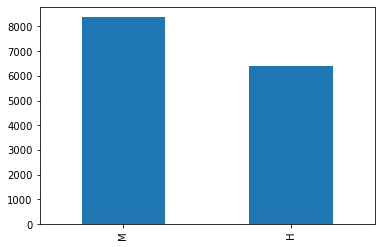

In [63]:
#Histobram for Sex
patient['Sex'].value_counts().plot(kind='bar')
#Comments: More Male patients than Female patients

<AxesSubplot:>

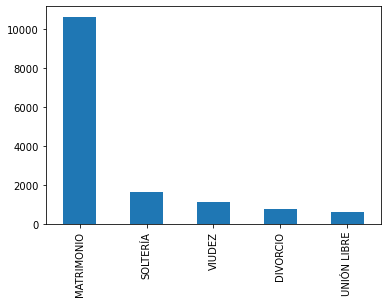

In [64]:
#Histrobram for Marital status
patient['Marital status'].value_counts().plot(kind='bar')

#Matrimonio -> Married from majroity of the people

<AxesSubplot:>

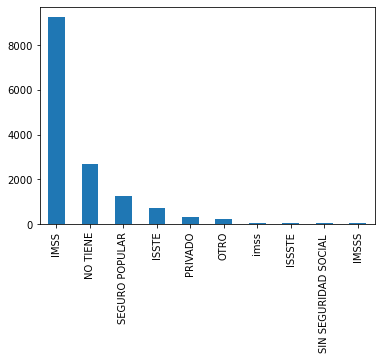

In [65]:
#Histrobram for Social Security
patient['Social Security'].value_counts().iloc[:10].plot(kind='bar')

#The frequencies of few categories way more higher than others. 

In [66]:
patient.groupby('Social Security')['Social Security'].count().sort_values(ascending=False)[1:15]
#Most patients social security status are: IMSS, NO TIENE, SEGURO POPULAR

Social Security
NO TIENE                 2682
SEGURO POPULAR           1271
ISSTE                     708
PRIVADO                   320
OTRO                      210
imss                       48
ISSSTE                     39
SIN SEGURIDAD SOCIAL       33
IMSSS                      28
NO                         19
no tiene                   17
seguro popular             14
NINGUNA                    14
SEGURO POPULAR             12
Name: Social Security, dtype: int64

<AxesSubplot:>

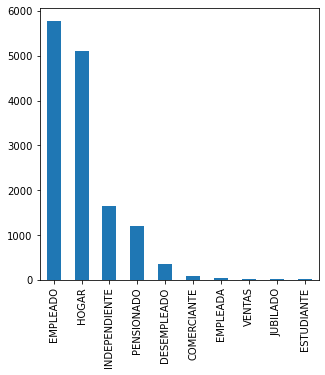

In [67]:
#Histobram for Ocupacion
fig, ax = plt.subplots(figsize=(5, 5))
patient['Ocupacion'].value_counts().iloc[:10].plot(kind='bar')

#Comments: Few occupations are way more higher than other.

In [68]:
patient.groupby('Ocupacion')['Ocupacion'].count().sort_values(ascending=False)[1:15]
#Top 4 occpuations for patients: HOGAR, EMPLEADO, INDEPENDIENTE, PENSIONADO

Ocupacion
HOGAR            5099
INDEPENDIENTE    1657
PENSIONADO       1213
DESEMPLEADO       361
COMERCIANTE        86
EMPLEADA           44
VENTAS             26
JUBILADO           22
ESTUDIANTE         20
TAXISTA            19
MAESTRA            18
JUBILADA           15
CHOFER             14
EMPLEADO           13
Name: Ocupacion, dtype: int64

In [69]:
#Group by Town, State and have diabetes
patient.groupby(['Town','State'])['Patient ID'].count().sort_values(ascending=False)[1:20]

#Most patients are from NUEVO LEÓN: MONTERREY, GUADALUPE, APODACA, SANTA CATARINA (~50%)

Town                       State     
GUADALUPE                  NUEVO LEÓN    2654
APODACA                    NUEVO LEÓN    1438
SANTA CATARINA             NUEVO LEÓN    1438
SAN NICOLÁS DE LOS GARZA   NUEVO LEÓN     931
GENERAL ESCOBEDO           NUEVO LEÓN     737
ESCOBEDO                   NUEVO LEÓN     613
JUÁREZ                     NUEVO LEÓN     439
MONTERREY                  NUEVO LEÓN     343
SAN NICOLAS                NUEVO LEÓN     329
GARCÍA                     NUEVO LEÓN     266
JUAREZ                     NUEVO LEÓN     253
SANTA CATARINA             NUEVO LEÓN     199
SAN PEDRO                  NUEVO LEÓN     162
SAN PEDRO GARZA GARCÍA     NUEVO LEÓN     158
GARCIA                     NUEVO LEÓN     138
GUADALUPE                  NUEVO LEÓN      96
GPE                        NUEVO LEÓN      91
SAN NICOLAS DE LOS GARZA   NUEVO LEÓN      86
SAN NICOLAS DE LOS GARZA   NUEVO LEÓN      69
Name: Patient ID, dtype: int64

### Q4
Demographics, from the input files Balance – Tablas (Parte 1). For example marital status could be derived from EstadoCivil

**Geography**, from the input files Balance – Tablas (Parte 1). For example, distance from clinic is dependent on city and state which are in Ciudad and Estado respectively

**Demographics** Patient ID , Sex, YearBirth, Marital status, Ocupacion

In [70]:
#Q4 Demographics, from the input files Balance – Tablas (Parte 1). For example marital status could be derived from EstadoCivil
#Geography, from the input files Balance – Tablas (Parte 1). For example,
#distance from clinic is dependent on city and state which are in Ciudad and Estado respectively

#Demographics: Patient ID , Sex, YearBirth, Marital status, Ocupacion
#Those selected variables are related to patients'demographics information. 
patient_demographics = patient[['Patient ID','Sex', 'YearBirth' , 'Marital status' , 'Ocupacion']]   
patient_demographics.to_csv("patient_demographics.csv", index=False)
#Geography: Patient ID ,'Town','State'
#Those selected variables are related to patients' geographic location and the clinic branch they go to. 
patient_geography = patient[['Patient ID','Town', 'State', 'Branch id']]   
patient_geography.to_csv("patient_geography.csv", index=False)


In [71]:
#Demographics
print(patient_demographics.describe())
print(patient_demographics.head(n = 10))
#Geography
print(patient_geography.describe())
print(patient_geography.head(n = 10))

         Patient ID     YearBirth
count  14773.000000  14773.000000
mean    7637.252352   1962.465308
std     4312.153994     12.243124
min        1.000000   1926.000000
25%     3942.000000   1954.000000
50%     7663.000000   1962.000000
75%    11365.000000   1971.000000
max    15068.000000   2000.000000
   Patient ID Sex  YearBirth Marital status              Ocupacion
0           1   H     1928.0       SOLTERÍA                ALBAÑIL
1           2   H     1971.0     MATRIMONIO  INSTALACION MECANICA 
2           3   M     1943.0     MATRIMONIO                  HOGAR
3           4   H     1976.0       SOLTERÍA               EMPLEADO
4           5   H     1958.0     MATRIMONIO                 CASADO
5           6   H     1957.0       SOLTERÍA               EMPLEADO
6           7   M     1958.0     MATRIMONIO        MAESTRA JUBILDA
7           8   M     1977.0     MATRIMONIO              ESTILISTA
8           9   M     1952.0     MATRIMONIO                  HOGAR
9          10   M     19